<a href="https://colab.research.google.com/github/DH-davidhuang/Generative-Adversarial-182-Networks-Research/blob/main/182_Research_GANS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
! pip install -q kaggle
from google.colab import files

In [ ]:
# Create the .kaggle directory
!mkdir ~/.kaggle

# Move the kaggle.json file into this directory
!mv kaggle.json ~/.kaggle/

# Change the permissions of the file
!chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle’: File exists
mv: cannot stat 'kaggle.json': No such file or directory


In [ ]:
#import necessary libraries
import torch, torchvision
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
from torchvision import transforms
from torch import nn, optim
from torchvision.utils import make_grid
from torchvision.utils import save_image
from tqdm.notebook import tqdm
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from PIL import Image
import kaggle

%matplotlib inline
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.cpu().detach()[:nmax]), nrow=8).permute(1, 2, 0))
#TODO: define your own dataset address"

def download_data():
    kaggle.api.authenticate()
    kaggle.api.dataset_download_files('lunarwhite/anime-face-dataset-ntumlds', path='./', unzip=True)

download_data()

root = './faces/images/'

In [ ]:
from PIL import Image
import glob
image_list = []
rows = []
for filename in glob.glob('./images/*.jpg'):
    im=Image.open(filename)
    rows.append([filename])
    image_list.append(filename)

print(len(image_list))

36740


(64, 64, 64, 3)


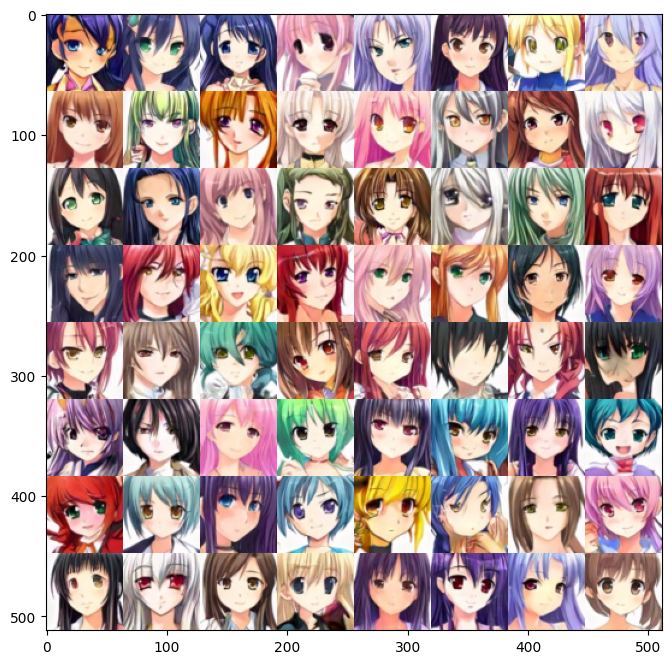

In [ ]:
def gallery(array, ncols=8):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    result = (array.reshape(nrows, ncols, height, width, intensity)
              .swapaxes(1,2)
              .reshape(height*nrows, width*ncols, intensity))
    return result

from PIL import Image
import random
def make_array():

    arr = []
    # Randomly select 64 images to visualize
    for i in range(64):
        random_image = random.choice(image_list)
        arr.append(np.asarray(Image.open(random_image).convert('RGB')))
    print(np.array(arr).shape)
    return np.array(arr)

array = make_array()
result = gallery(array)
plt.figure(figsize=(8,8))
plt.imshow(result)
plt.show()

In [ ]:
df = pd.DataFrame(rows)
df.to_csv('data.csv', index=False, header = None)

In [ ]:
#The batch_size is defined by yourself based on the memory of GPU or CPU.
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
transform = transforms.Compose([
                                transforms.CenterCrop(64),
                                transforms.Resize(64, interpolation=2),
                                transforms.ToTensor(),
                                transforms.Normalize(*stats)])
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

class AnimeData(Dataset):
    """
    Wrap the data into a Dataset class, and then pass it to the DataLoader
    :__init__: Initialization data
    :__getitem__: support the indexing such that dataset[i] can be used to get ith sample
    :__len__: return the size of the dataset.
    """
    def __init__(self, root, transform=None):
        self.frame = pd.read_csv(root, header=None)
        self.transform = transform


    def __len__(self):
        return len(self.frame)


    def __getitem__(self, index):
        image_name = self.frame.iloc[index, 0]
        image = Image.open(image_name)
        image = self.transform(image)
        return image
#TODO: Complete the trainloader
trainset = AnimeData(root='./data.csv', transform=transform)
trainloader = DataLoader(trainset, batch_size, shuffle=True, num_workers=0)

In [ ]:
if torch.cuda.is_available():
    device=torch.device('cuda')
else:
    device=torch.device('cpu')

In [ ]:
#TODO: Create your Discriminator model
class Discriminator(nn.Module):
    def __init__(self,inchannels):
        super(Discriminator,self).__init__()
        """
        Initialize the Discriminator Module
        :param inchannels: The depth of the first convolutional layer
        """
        self.conv_block1 = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace = True),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=2, padding=0),
            nn.Flatten(),
            nn.Sigmoid()
        )

    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network
        :return: Discriminator logits; the output of the neural network
        """
        x = self.conv_block1(x)
        return x

D=Discriminator(3).to(device)

torch.Size([128, 3, 64, 64])


  0%|          | 0/288 [00:00<?, ?it/s]

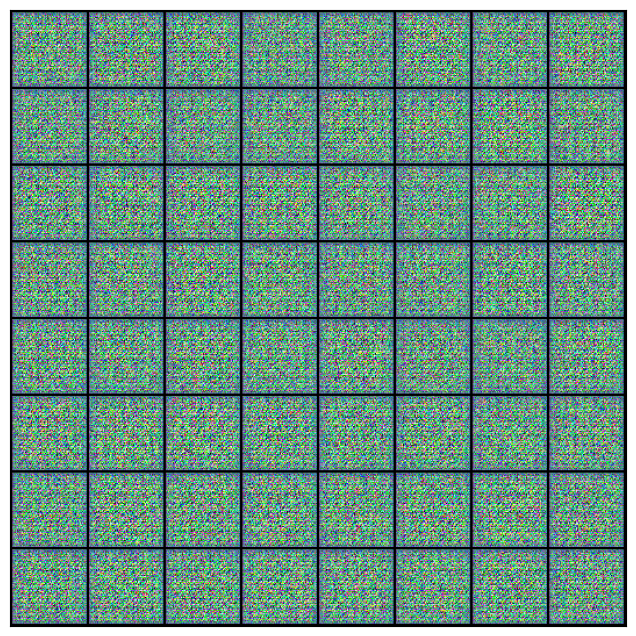

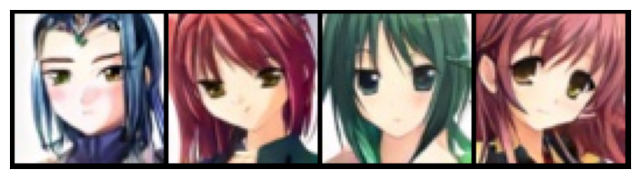

In [ ]:
# Create your Generator model
latent_size = 128
class Generator(nn.Module):
    def __init__(self,latent_size):
        super(Generator,self).__init__()
        """
        Initialize the Generator Module
        :param latent_size: The length of the input latent vector
        """
        self.conv_block1 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_size, out_channels=512, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network
        :return: A 3x64x64 Tensor image as output
        """
        x = self.conv_block1(x)
        return x


G=Generator(latent_size).to(device)
# random latent tensors
noise = torch.randn(batch_size, latent_size, 1, 1).to(device)

fake_images = G(noise)
print(fake_images.shape)

fake_images.to(device)

show_images(fake_images)

for real_images in tqdm(trainloader):
    real_images=(real_images).to(device)

show_images(real_images)

In [ ]:
loss_fn = torch.nn.MSELoss()
def Real_loss(preds,targets):
    '''
       Calculates how close discriminator outputs are to being real.
       param, D_out: discriminator logits
       return: real loss
    '''
    beta_distr = torch.distributions.beta.Beta(1,5,validate_args=None)
    label_noise = beta_distr.sample(sample_shape=targets.shape).to(torch.device(device))
    loss= loss_fn(targets,preds-label_noise)
    return loss
def Fake_loss(preds,targets):
    '''
       Calculates how close discriminator outputs are to being fake.
       param, D_out: discriminator logits
       return: fake loss
    '''
    beta_distr = torch.distributions.beta.Beta(1,5,validate_args=None)
    label_noise = beta_distr.sample(sample_shape=targets.shape).to(torch.device(device))
    loss= loss_fn(targets,preds+label_noise)
    return loss

In [ ]:
# Create optimizers for the discriminator D and generator G
#Define your learning rate
lr=0.0002
opt_d = optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
opt_g = optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))

In [ ]:
##Define your save path.
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)
def save_samples(index, latent_tensors, generator, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))
        plt.show()
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [1/15], loss_g: 0.7108, loss_d: 0.0658, real_score: 0.8741, fake_score: 0.0002
Saving generated-images-0001.png


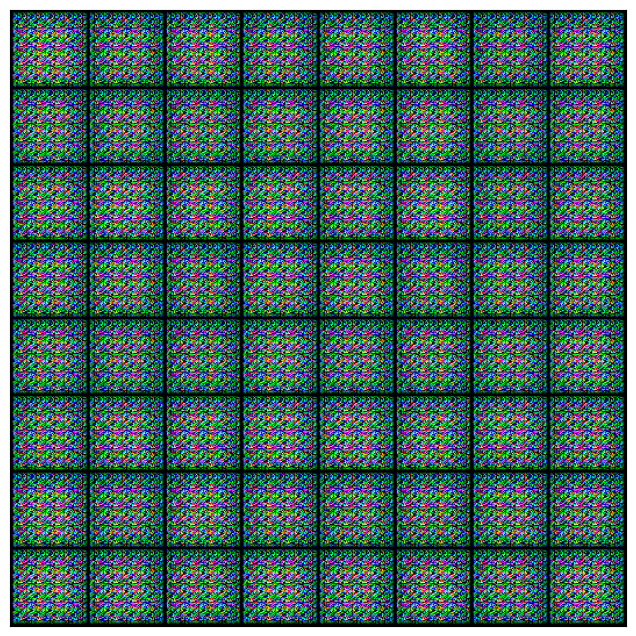

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [2/15], loss_g: 0.2518, loss_d: 0.2349, real_score: 0.4523, fake_score: 0.2986
Saving generated-images-0002.png


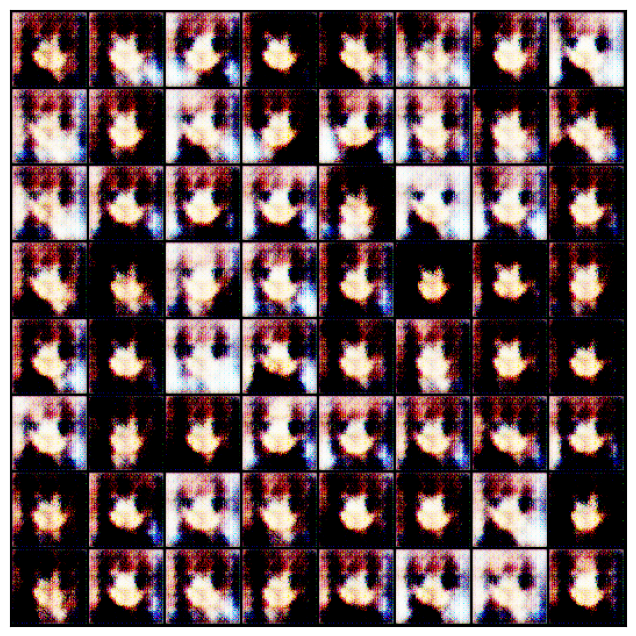

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [3/15], loss_g: 0.6687, loss_d: 0.1653, real_score: 0.8899, fake_score: 0.5383
Saving generated-images-0003.png


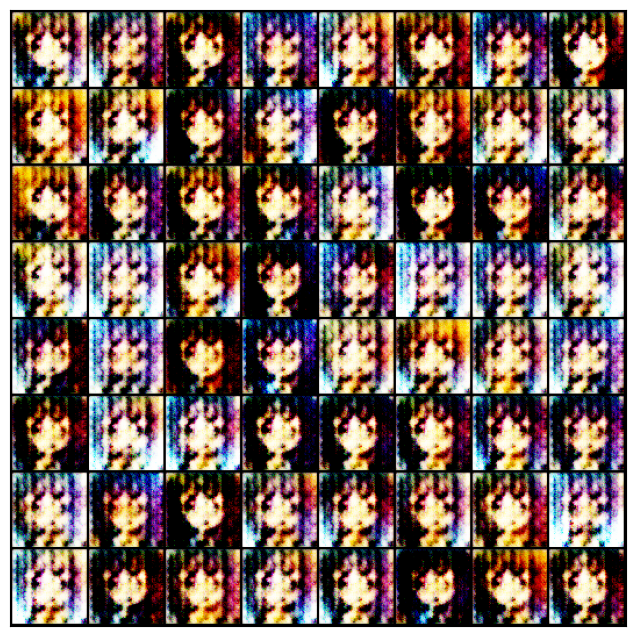

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [4/15], loss_g: 0.6565, loss_d: 0.2018, real_score: 0.8697, fake_score: 0.5626
Saving generated-images-0004.png


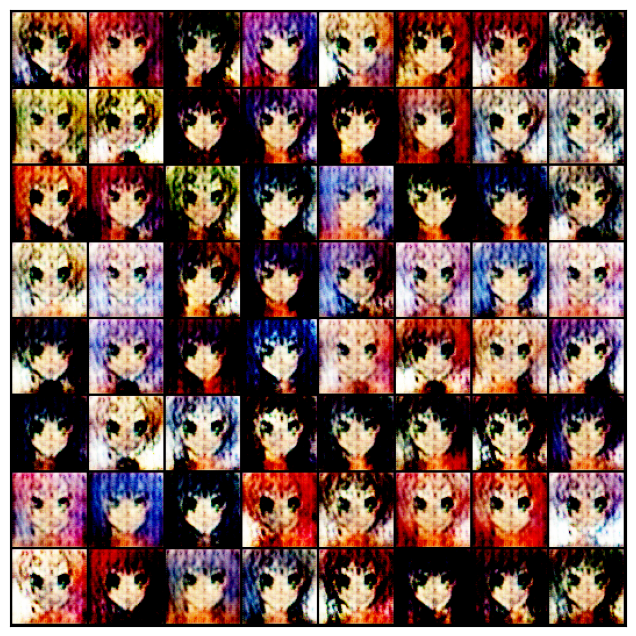

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [5/15], loss_g: 0.5796, loss_d: 0.1019, real_score: 0.8145, fake_score: 0.3878
Saving generated-images-0005.png


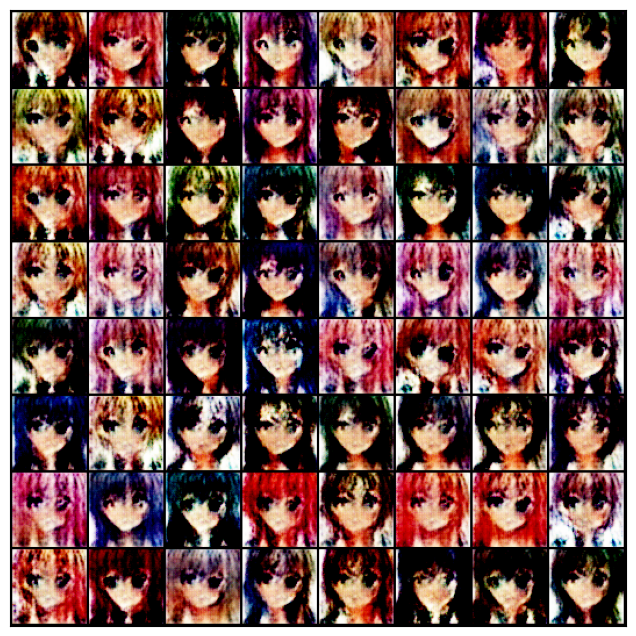

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [6/15], loss_g: 0.4715, loss_d: 0.0953, real_score: 0.5635, fake_score: 0.3184
Saving generated-images-0006.png


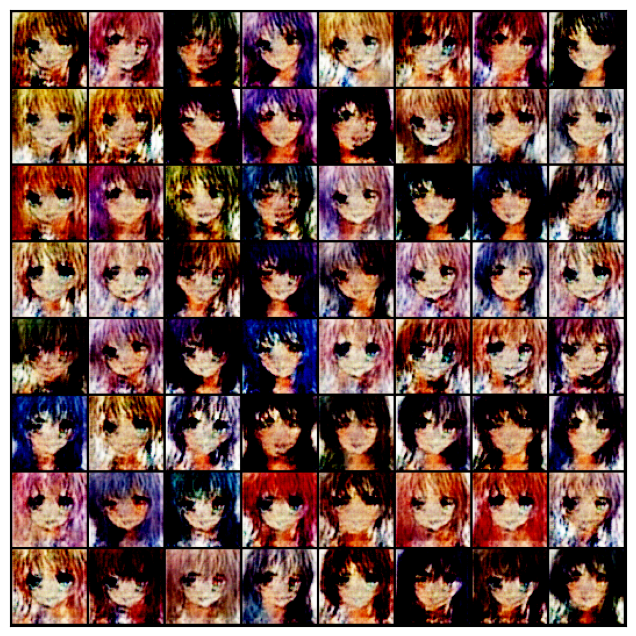

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [7/15], loss_g: 0.2322, loss_d: 0.1179, real_score: 0.6051, fake_score: 0.2382
Saving generated-images-0007.png


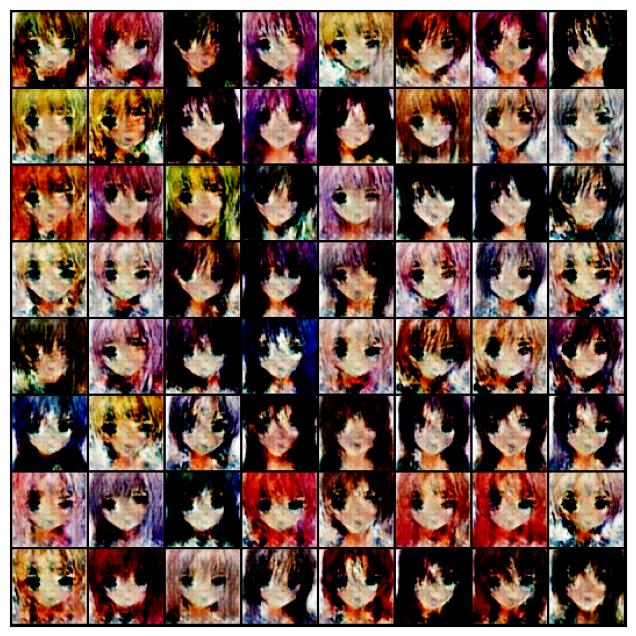

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [8/15], loss_g: 0.6204, loss_d: 0.0459, real_score: 0.8428, fake_score: 0.1539
Saving generated-images-0008.png


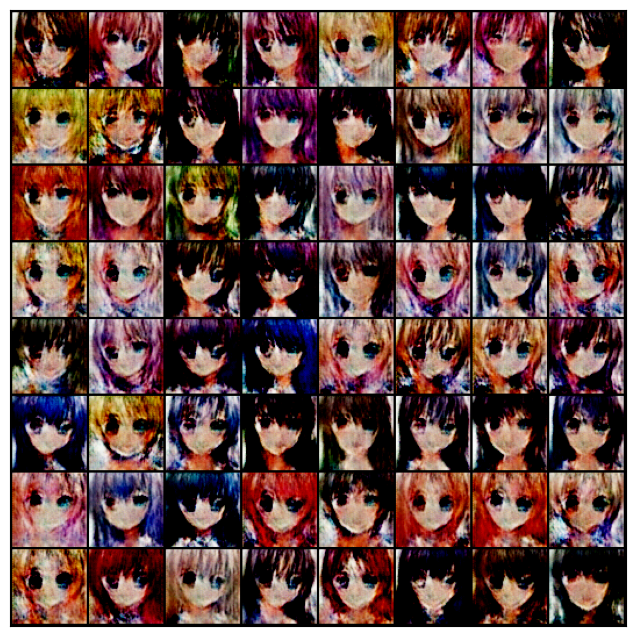

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [9/15], loss_g: 0.6616, loss_d: 0.0925, real_score: 0.8987, fake_score: 0.0916
Saving generated-images-0009.png


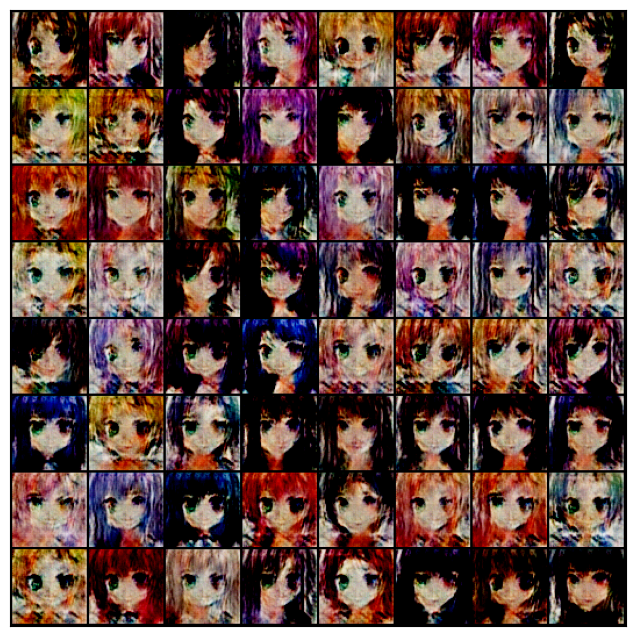

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [10/15], loss_g: 0.3269, loss_d: 0.1996, real_score: 0.5373, fake_score: 0.1480
Saving generated-images-0010.png


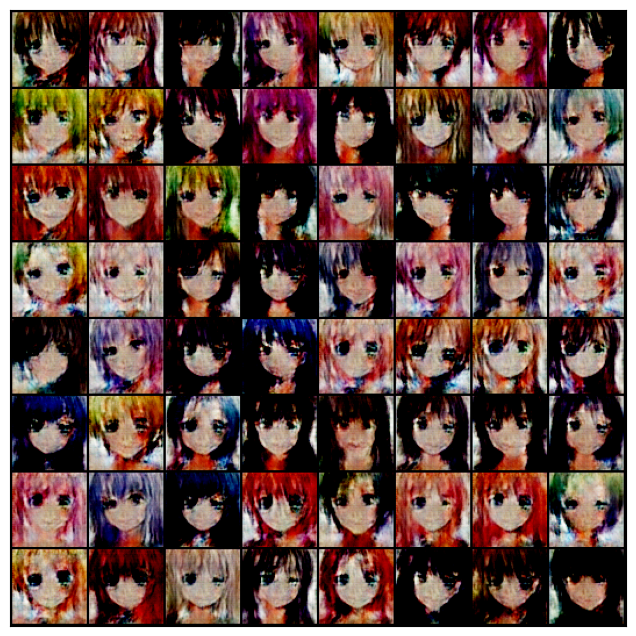

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [11/15], loss_g: 0.3816, loss_d: 0.1024, real_score: 0.6609, fake_score: 0.0352
Saving generated-images-0011.png


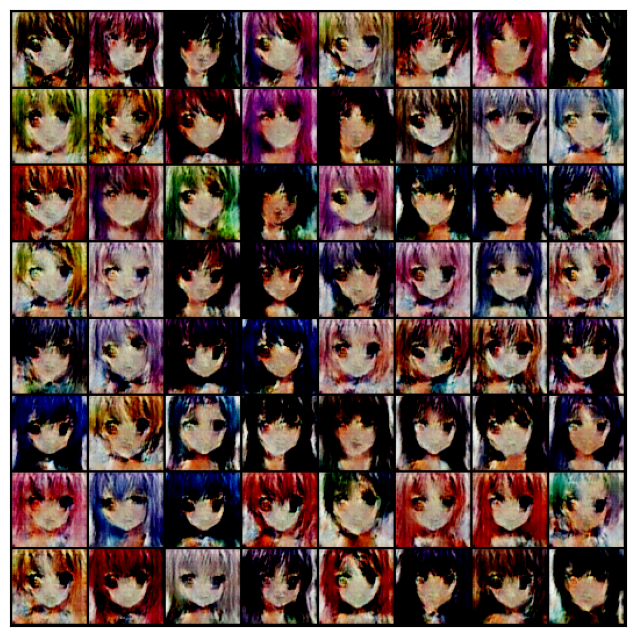

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [12/15], loss_g: 0.2677, loss_d: 0.1048, real_score: 0.6882, fake_score: 0.2565
Saving generated-images-0012.png


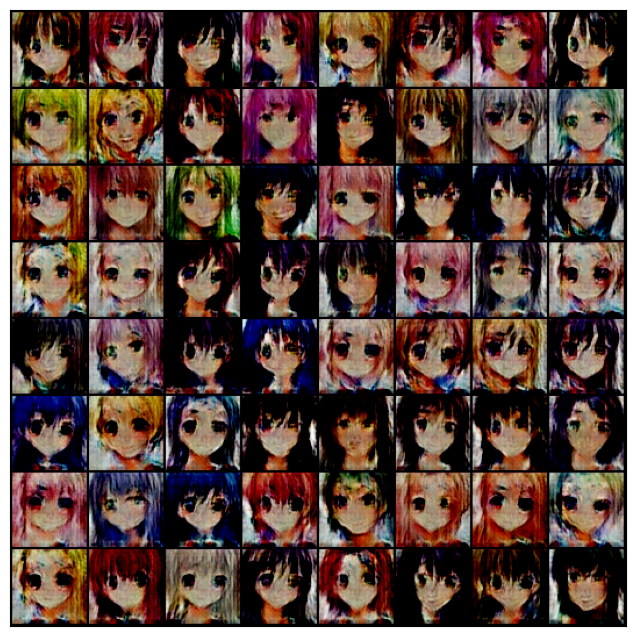

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [13/15], loss_g: 0.4813, loss_d: 0.0800, real_score: 0.5840, fake_score: 0.1101
Saving generated-images-0013.png


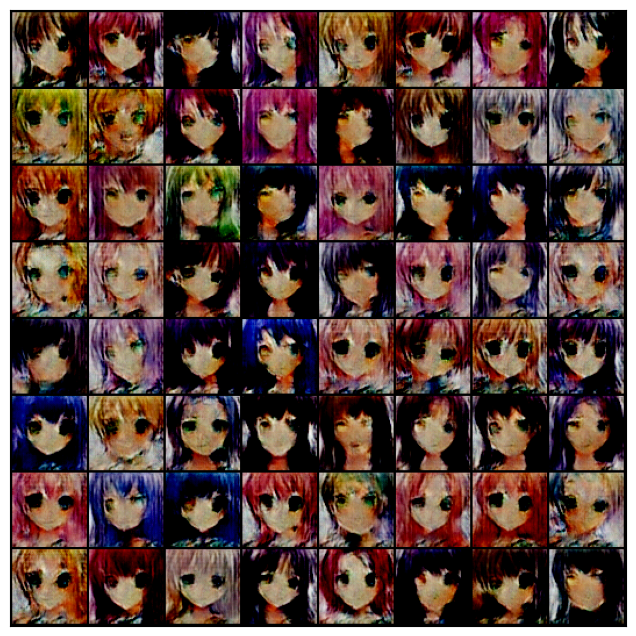

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [14/15], loss_g: 0.5695, loss_d: 0.0495, real_score: 0.7654, fake_score: 0.2498
Saving generated-images-0014.png


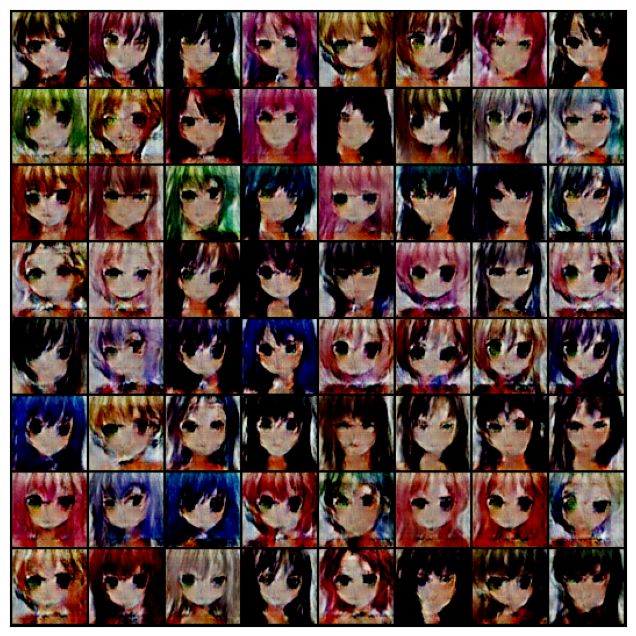

  0%|          | 0/288 [00:00<?, ?it/s]

Epoch [15/15], loss_g: 0.5938, loss_d: 0.0668, real_score: 0.8259, fake_score: 0.3251
Saving generated-images-0015.png


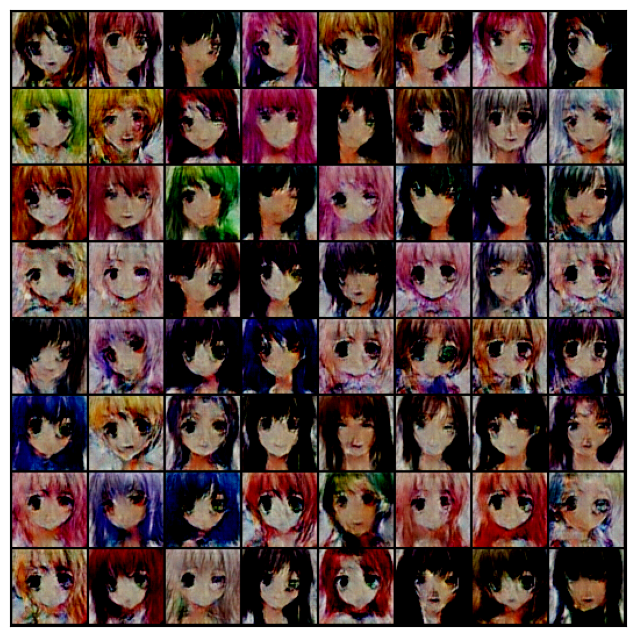

In [ ]:
# Complete the training function
losses_g = []
losses_d = []
real_scores = []
fake_scores = []
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(trainloader):
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(batch_size, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(batch_size, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)

                # Update generator weights
                g_optimizer.zero_grad()
                loss_g.backward(retain_graph = (i<gen_steps -1 ))
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        save_samples(epoch+start_idx, fixed_latent,G, show=True)

        state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
        state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
        if not os.path.isdir('checkpoint'):
            os.mkdir('checkpoint')
        torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(D,G,opt_d,opt_g,epochs=15)

In [ ]:
import torch

# Assuming 'model' is your PyTorch model
# Specify the file path where you want to save the model weights
save_path = 'base_line_model.pth'

# Save the model's state dictionary to the specified file
torch.save(G.state_dict(), save_path)
torch.save(D.state_dict(), 'base_line_D.pth')

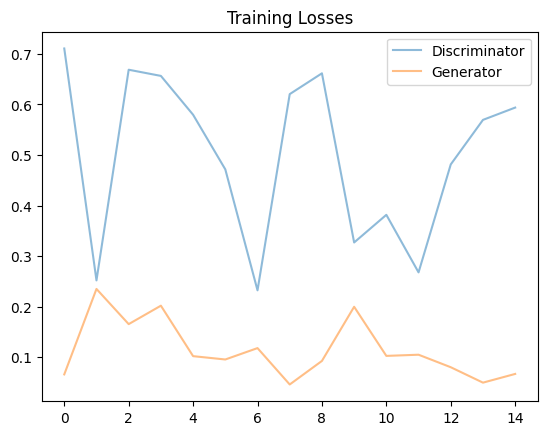

In [ ]:
##Visualize your loss curve of D and G
fig, ax = plt.subplots()
plt.plot(losses_g, label='Discriminator', alpha=0.5)
plt.plot(losses_d, label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:

%matplotlib inline
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.cpu().detach()[:nmax]), nrow=8).permute(1, 2, 0))
#TODO: define your own dataset address"

def download_data():
    kaggle.api.authenticate()
    kaggle.api.dataset_download_files('marquis03/cats-and-dogs', path='./', unzip=True)

download_data()

root = './faces/images/'

In [ ]:
image_list = []
rows = []
for filename in glob.glob('./train/cat/*.jpg'):
    im=Image.open(filename)
    rows.append([filename])
    image_list.append(filename)

print(len(image_list))

95


In [ ]:
import skimage as sk
import skimage.io as skio

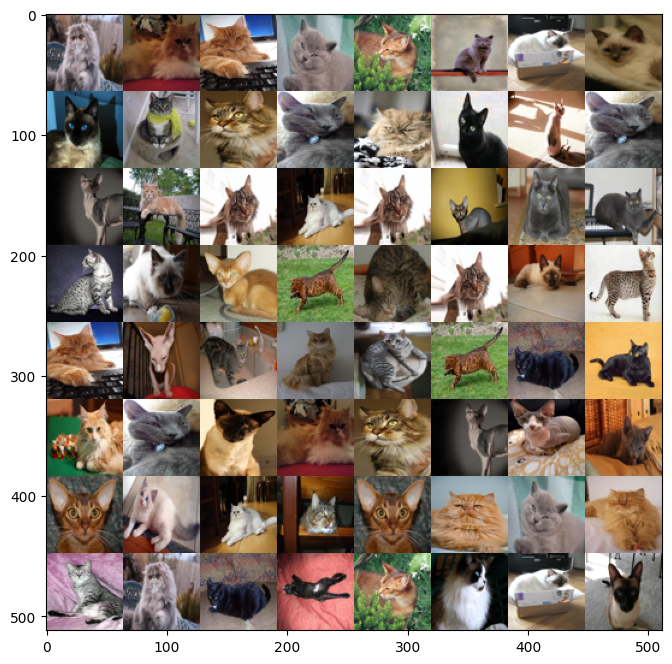

In [ ]:
def gallery(array, ncols=8):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    result = (array.reshape(nrows, ncols, height, width, intensity)
              .swapaxes(1,2)
              .reshape(height*nrows, width*ncols, intensity))
    return result

from PIL import Image
import random
def make_array():

    arr = []
    # Randomly select 64 images to visualize
    for i in range(64):
        random_image = random.choice(image_list)
        arr.append(np.asarray(Image.open(random_image).resize((64, 64)).convert('RGB')))
    arr = np.stack(arr, axis=0)

    return np.array(arr)

array = make_array()
result = gallery(array)
plt.figure(figsize=(8,8))
plt.imshow(result)
plt.show()

In [ ]:
df = pd.DataFrame(rows)
df.to_csv('traincats.csv', index=False, header = None)

In [ ]:
#The batch_size is defined by yourself based on the memory of GPU or CPU.
batch_size = 8
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
transform = transforms.Compose([
                                transforms.CenterCrop(64),
                                transforms.Resize(64, interpolation=2),
                                transforms.ToTensor(),
                                transforms.Normalize(*stats)])
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

class AnimeData(Dataset):
    """
    Wrap the data into a Dataset class, and then pass it to the DataLoader
    :__init__: Initialization data
    :__getitem__: support the indexing such that dataset[i] can be used to get ith sample
    :__len__: return the size of the dataset.
    """
    def __init__(self, root, transform=None):
        self.frame = pd.read_csv(root, header=None)
        self.transform = transform


    def __len__(self):
        return len(self.frame)


    def __getitem__(self, index):
        image_name = self.frame.iloc[index, 0]
        image = Image.open(image_name)
        image = self.transform(image)
        return image
#TODO: Complete the trainloader
trainset = AnimeData(root='./traincats.csv', transform=transform)
trainloader = DataLoader(trainset, batch_size, shuffle=True, num_workers=0)

In [ ]:
len(trainloader)

12

torch.Size([128, 3, 64, 64])


  0%|          | 0/1 [00:00<?, ?it/s]

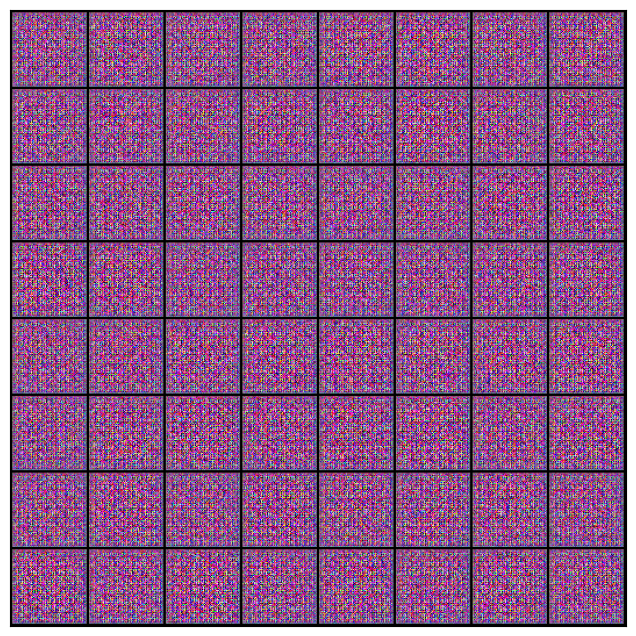

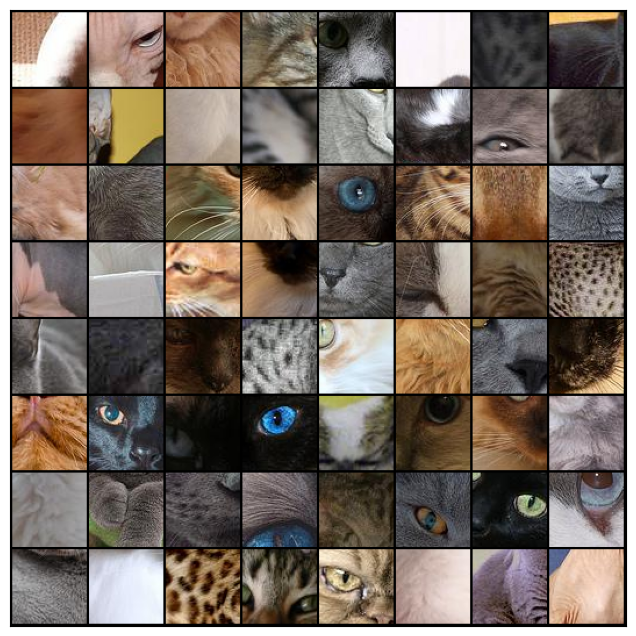

In [ ]:
# Create your Generator model
latent_size = 128
class Generator(nn.Module):
    def __init__(self,latent_size):
        super(Generator,self).__init__()
        """
        Initialize the Generator Module
        :param latent_size: The length of the input latent vector
        """
        self.conv_block1 = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_size, out_channels=512, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network
        :return: A 3x64x64 Tensor image as output
        """
        x = self.conv_block1(x)
        return x


G=Generator(latent_size).to(device)
# random latent tensors
noise = torch.randn(batch_size, latent_size, 1, 1).to(device)

fake_images = G(noise)
print(fake_images.shape)

fake_images.to(device)

show_images(fake_images)

for real_images in tqdm(trainloader):
    real_images=(real_images).to(device)

show_images(real_images)

In [ ]:
##Define your save path.
sample_dir = 'generated2'
os.makedirs(sample_dir, exist_ok=True)
def save_samples(index, latent_tensors, generator, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated2-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))
        plt.show()
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

In [ ]:
save_path = 'base_line_model.pth'

G.load_state_dict(torch.load(save_path))
D.load_state_dict(torch.load('base_line_D.pth'))

<All keys matched successfully>

In [ ]:
print(len(tqdm(trainloader)))

  0%|          | 0/12 [00:00<?, ?it/s]

12


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [1/100], loss_g: 0.4879, loss_d: 0.0630, real_score: 0.8516, fake_score: 0.1444
Saving generated2-images-0001.png


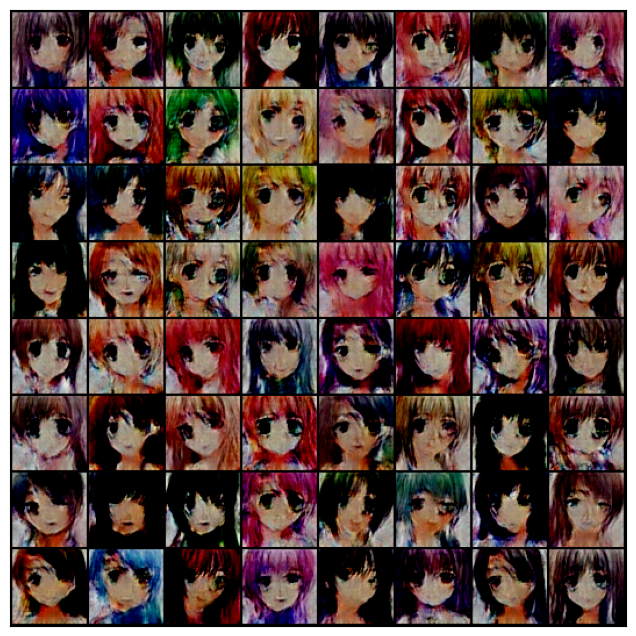

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [2/100], loss_g: 0.5598, loss_d: 0.0287, real_score: 0.8288, fake_score: 0.1522


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [3/100], loss_g: 0.4991, loss_d: 0.0589, real_score: 0.8967, fake_score: 0.1672


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [4/100], loss_g: 0.5270, loss_d: 0.0512, real_score: 0.8327, fake_score: 0.1340


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [5/100], loss_g: 0.5915, loss_d: 0.0446, real_score: 0.8235, fake_score: 0.1302


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [6/100], loss_g: 0.5522, loss_d: 0.0284, real_score: 0.8387, fake_score: 0.1094


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [7/100], loss_g: 0.4768, loss_d: 0.0494, real_score: 0.8549, fake_score: 0.1332


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [8/100], loss_g: 0.4970, loss_d: 0.0367, real_score: 0.8243, fake_score: 0.1699


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [9/100], loss_g: 0.4466, loss_d: 0.0476, real_score: 0.8395, fake_score: 0.1854


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [10/100], loss_g: 0.4130, loss_d: 0.0724, real_score: 0.8754, fake_score: 0.1912


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [11/100], loss_g: 0.5304, loss_d: 0.0812, real_score: 0.8685, fake_score: 0.1276
Saving generated2-images-0011.png


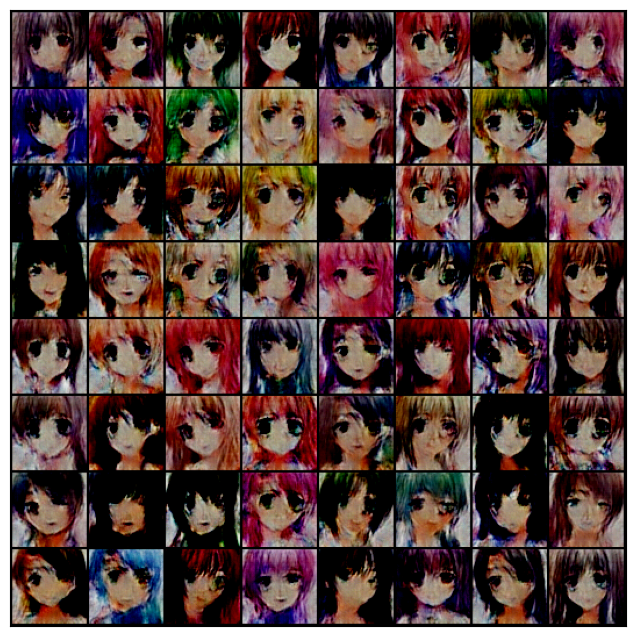

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [12/100], loss_g: 0.4014, loss_d: 0.0703, real_score: 0.8918, fake_score: 0.2466


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [13/100], loss_g: 0.4491, loss_d: 0.0185, real_score: 0.8525, fake_score: 0.1445


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [14/100], loss_g: 0.3853, loss_d: 0.0242, real_score: 0.8721, fake_score: 0.1942


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [15/100], loss_g: 0.4943, loss_d: 0.0145, real_score: 0.8370, fake_score: 0.1548


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [16/100], loss_g: 0.5353, loss_d: 0.0462, real_score: 0.8009, fake_score: 0.1838


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [17/100], loss_g: 0.5703, loss_d: 0.0494, real_score: 0.8773, fake_score: 0.1510


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [18/100], loss_g: 0.4995, loss_d: 0.0810, real_score: 0.8331, fake_score: 0.1390


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [19/100], loss_g: 0.6089, loss_d: 0.0339, real_score: 0.8019, fake_score: 0.1121


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [20/100], loss_g: 0.4688, loss_d: 0.0733, real_score: 0.8781, fake_score: 0.1423


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [21/100], loss_g: 0.4944, loss_d: 0.0408, real_score: 0.8565, fake_score: 0.2109
Saving generated2-images-0021.png


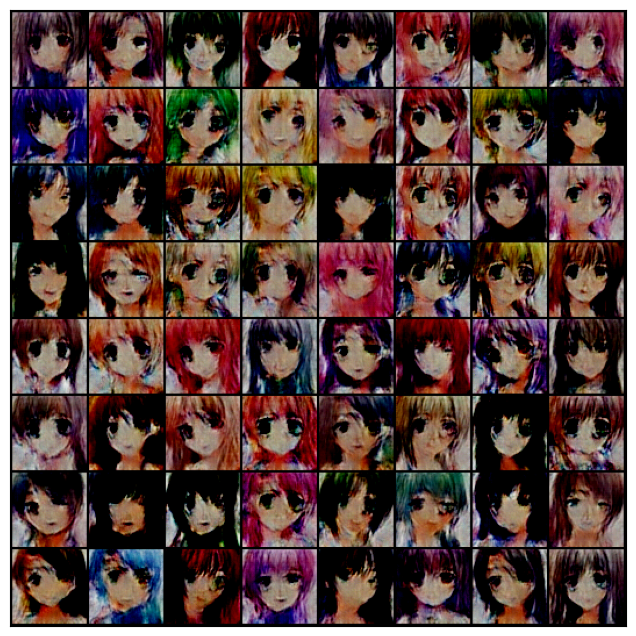

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [22/100], loss_g: 0.4534, loss_d: 0.0605, real_score: 0.8852, fake_score: 0.1815


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [23/100], loss_g: 0.5762, loss_d: 0.0282, real_score: 0.8360, fake_score: 0.1632


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [24/100], loss_g: 0.4791, loss_d: 0.0391, real_score: 0.8658, fake_score: 0.1987


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [25/100], loss_g: 0.5195, loss_d: 0.0308, real_score: 0.8714, fake_score: 0.1343


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [26/100], loss_g: 0.4556, loss_d: 0.0168, real_score: 0.7933, fake_score: 0.1244


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [27/100], loss_g: 0.5142, loss_d: 0.0154, real_score: 0.8603, fake_score: 0.0902


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [28/100], loss_g: 0.6098, loss_d: 0.1067, real_score: 0.8901, fake_score: 0.1422


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [29/100], loss_g: 0.3163, loss_d: 0.0333, real_score: 0.8530, fake_score: 0.1270


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [30/100], loss_g: 0.4782, loss_d: 0.0648, real_score: 0.8851, fake_score: 0.1802


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [31/100], loss_g: 0.5374, loss_d: 0.0402, real_score: 0.8425, fake_score: 0.1188
Saving generated2-images-0031.png


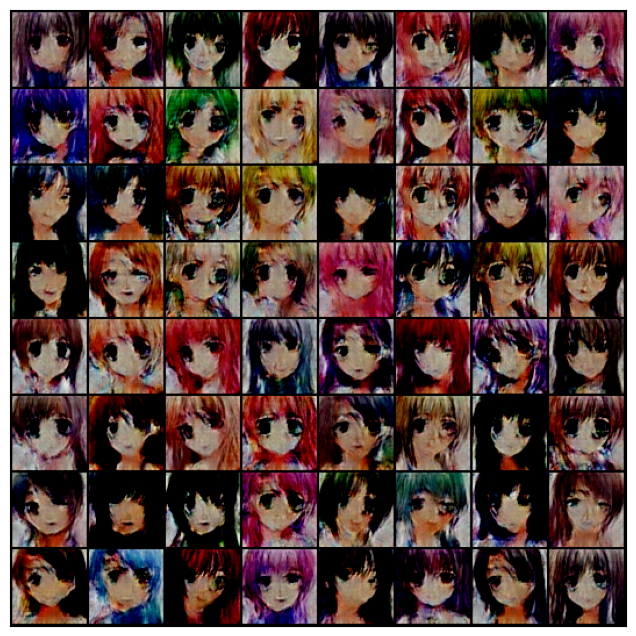

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [32/100], loss_g: 0.3708, loss_d: 0.0352, real_score: 0.8667, fake_score: 0.1365


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [33/100], loss_g: 0.3959, loss_d: 0.0573, real_score: 0.8826, fake_score: 0.1975


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [34/100], loss_g: 0.5978, loss_d: 0.0626, real_score: 0.8703, fake_score: 0.1064


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [35/100], loss_g: 0.3593, loss_d: 0.0293, real_score: 0.8716, fake_score: 0.2355


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [36/100], loss_g: 0.5020, loss_d: 0.0495, real_score: 0.8481, fake_score: 0.1533


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [37/100], loss_g: 0.4245, loss_d: 0.0271, real_score: 0.8751, fake_score: 0.1760


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [38/100], loss_g: 0.4572, loss_d: 0.0497, real_score: 0.8638, fake_score: 0.1918


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [39/100], loss_g: 0.5394, loss_d: 0.0573, real_score: 0.8635, fake_score: 0.2099


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [40/100], loss_g: 0.4728, loss_d: 0.0750, real_score: 0.8204, fake_score: 0.1311


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [41/100], loss_g: 0.5459, loss_d: 0.0609, real_score: 0.9088, fake_score: 0.1801
Saving generated2-images-0041.png


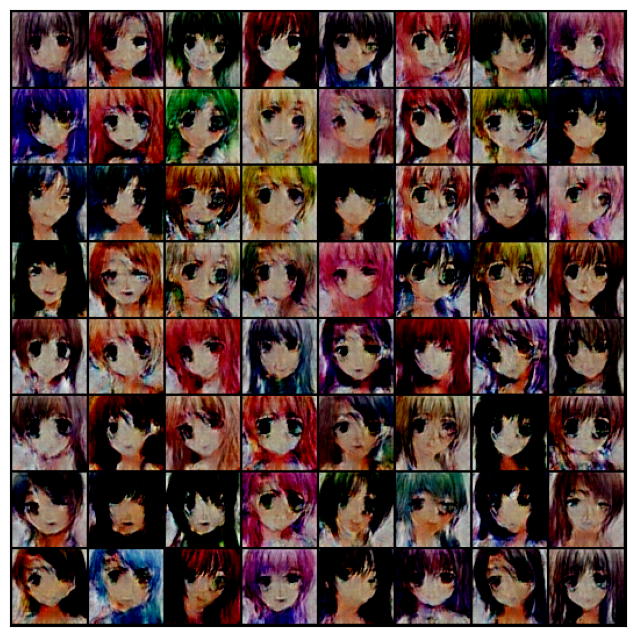

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [42/100], loss_g: 0.4777, loss_d: 0.0269, real_score: 0.8894, fake_score: 0.1468


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [43/100], loss_g: 0.4810, loss_d: 0.0408, real_score: 0.8601, fake_score: 0.1598


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [44/100], loss_g: 0.5201, loss_d: 0.1250, real_score: 0.8767, fake_score: 0.1437


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [45/100], loss_g: 0.5225, loss_d: 0.0414, real_score: 0.8629, fake_score: 0.1387


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [46/100], loss_g: 0.5807, loss_d: 0.0341, real_score: 0.8006, fake_score: 0.1594


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [47/100], loss_g: 0.4301, loss_d: 0.0470, real_score: 0.8407, fake_score: 0.1590


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [48/100], loss_g: 0.4864, loss_d: 0.0345, real_score: 0.8698, fake_score: 0.1000


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [49/100], loss_g: 0.5032, loss_d: 0.0576, real_score: 0.8539, fake_score: 0.1557


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [50/100], loss_g: 0.5319, loss_d: 0.0412, real_score: 0.8382, fake_score: 0.1284


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [51/100], loss_g: 0.4619, loss_d: 0.0223, real_score: 0.8319, fake_score: 0.1424
Saving generated2-images-0051.png


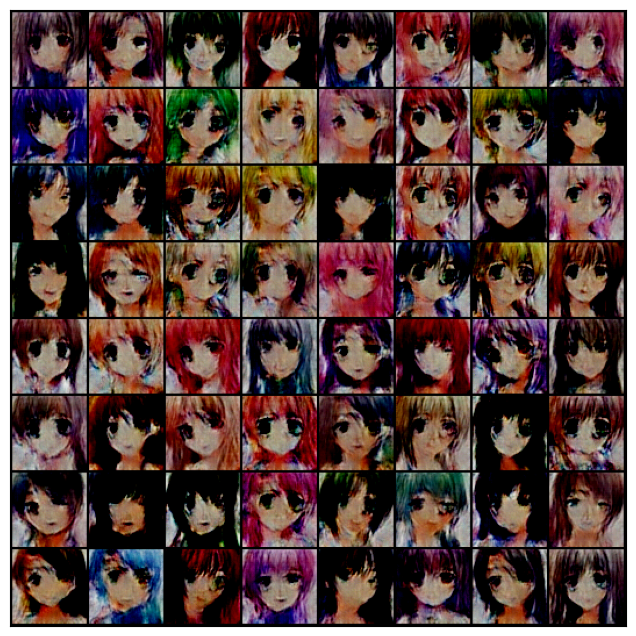

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [52/100], loss_g: 0.3618, loss_d: 0.0409, real_score: 0.8448, fake_score: 0.1565


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [53/100], loss_g: 0.4444, loss_d: 0.0107, real_score: 0.8265, fake_score: 0.1426


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [54/100], loss_g: 0.4897, loss_d: 0.0640, real_score: 0.8292, fake_score: 0.1361


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [55/100], loss_g: 0.4595, loss_d: 0.0212, real_score: 0.7935, fake_score: 0.1141


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [56/100], loss_g: 0.5317, loss_d: 0.0389, real_score: 0.8230, fake_score: 0.1237


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [57/100], loss_g: 0.5431, loss_d: 0.0491, real_score: 0.8388, fake_score: 0.1175


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [58/100], loss_g: 0.3647, loss_d: 0.0300, real_score: 0.8456, fake_score: 0.1903


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [59/100], loss_g: 0.4612, loss_d: 0.0607, real_score: 0.8028, fake_score: 0.1284


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [60/100], loss_g: 0.4387, loss_d: 0.0362, real_score: 0.8671, fake_score: 0.1804


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [61/100], loss_g: 0.4686, loss_d: 0.0661, real_score: 0.8935, fake_score: 0.2003
Saving generated2-images-0061.png


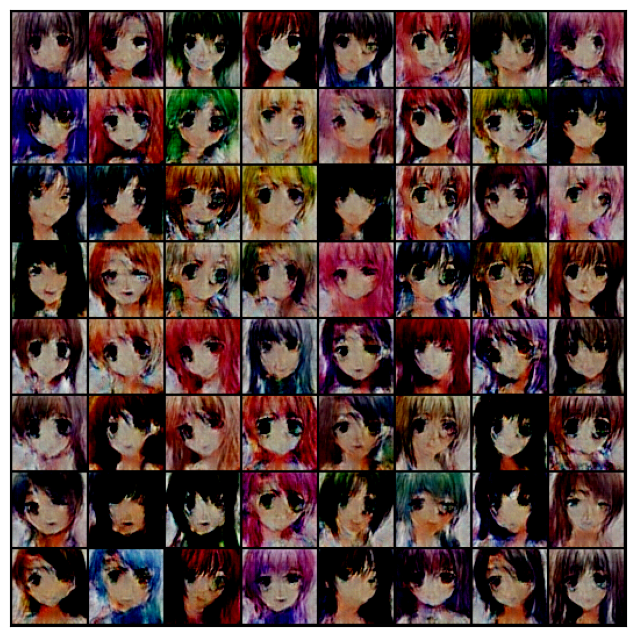

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [62/100], loss_g: 0.4362, loss_d: 0.0623, real_score: 0.8080, fake_score: 0.1126


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [63/100], loss_g: 0.5796, loss_d: 0.0199, real_score: 0.8302, fake_score: 0.1050


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [64/100], loss_g: 0.3698, loss_d: 0.0425, real_score: 0.8670, fake_score: 0.1443


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [65/100], loss_g: 0.5602, loss_d: 0.0948, real_score: 0.8050, fake_score: 0.1596


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [66/100], loss_g: 0.4140, loss_d: 0.0448, real_score: 0.8658, fake_score: 0.1784


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [67/100], loss_g: 0.5393, loss_d: 0.0554, real_score: 0.8702, fake_score: 0.1207


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [68/100], loss_g: 0.3639, loss_d: 0.0337, real_score: 0.8570, fake_score: 0.1262


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [69/100], loss_g: 0.4842, loss_d: 0.0394, real_score: 0.8413, fake_score: 0.1713


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [70/100], loss_g: 0.3119, loss_d: 0.0253, real_score: 0.8659, fake_score: 0.1671


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [71/100], loss_g: 0.6199, loss_d: 0.0489, real_score: 0.7822, fake_score: 0.0967
Saving generated2-images-0071.png


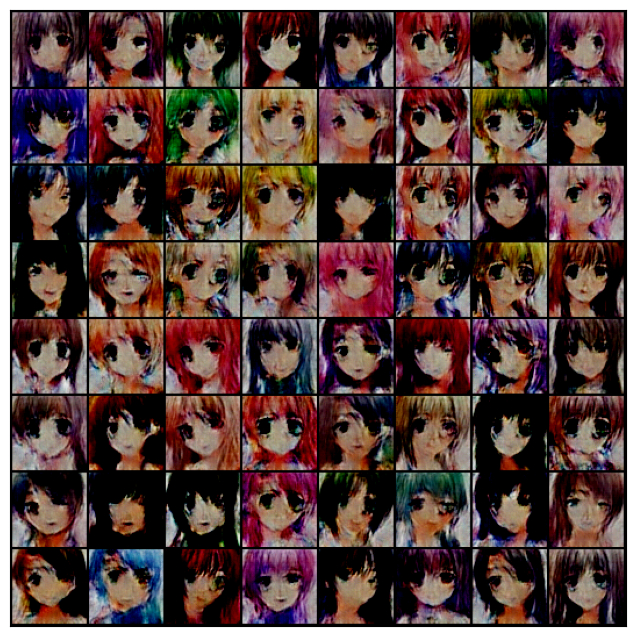

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [72/100], loss_g: 0.5606, loss_d: 0.0523, real_score: 0.8668, fake_score: 0.1412


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [73/100], loss_g: 0.5420, loss_d: 0.0617, real_score: 0.8392, fake_score: 0.1457


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [74/100], loss_g: 0.4724, loss_d: 0.0355, real_score: 0.8685, fake_score: 0.1936


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [75/100], loss_g: 0.5422, loss_d: 0.0416, real_score: 0.8210, fake_score: 0.1366


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [76/100], loss_g: 0.3715, loss_d: 0.0298, real_score: 0.8786, fake_score: 0.1240


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [77/100], loss_g: 0.5261, loss_d: 0.0545, real_score: 0.8540, fake_score: 0.1572


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [78/100], loss_g: 0.4585, loss_d: 0.0620, real_score: 0.8639, fake_score: 0.1816


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [79/100], loss_g: 0.4593, loss_d: 0.0665, real_score: 0.8732, fake_score: 0.1455


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [80/100], loss_g: 0.3970, loss_d: 0.0700, real_score: 0.8645, fake_score: 0.1007


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [81/100], loss_g: 0.5921, loss_d: 0.0181, real_score: 0.8353, fake_score: 0.1478
Saving generated2-images-0081.png


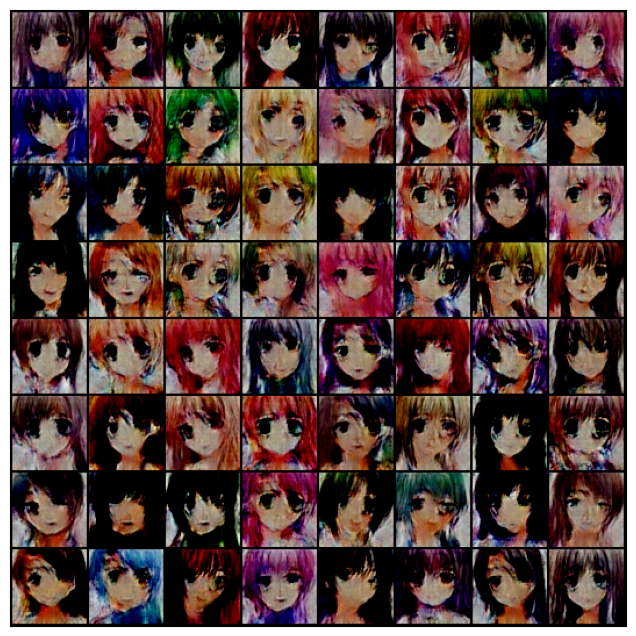

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [82/100], loss_g: 0.4575, loss_d: 0.0427, real_score: 0.8186, fake_score: 0.1292


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [83/100], loss_g: 0.3934, loss_d: 0.0337, real_score: 0.8455, fake_score: 0.2039


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [84/100], loss_g: 0.3201, loss_d: 0.0458, real_score: 0.8323, fake_score: 0.1571


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [85/100], loss_g: 0.4650, loss_d: 0.0391, real_score: 0.8556, fake_score: 0.2195


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [86/100], loss_g: 0.3875, loss_d: 0.0813, real_score: 0.8578, fake_score: 0.1877


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [87/100], loss_g: 0.5217, loss_d: 0.0526, real_score: 0.6971, fake_score: 0.0609


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [88/100], loss_g: 0.4985, loss_d: 0.0171, real_score: 0.8555, fake_score: 0.1661


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [89/100], loss_g: 0.4207, loss_d: 0.0177, real_score: 0.8260, fake_score: 0.1740


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [90/100], loss_g: 0.3354, loss_d: 0.0458, real_score: 0.8237, fake_score: 0.1244


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [91/100], loss_g: 0.2895, loss_d: 0.0549, real_score: 0.8508, fake_score: 0.1780
Saving generated2-images-0091.png


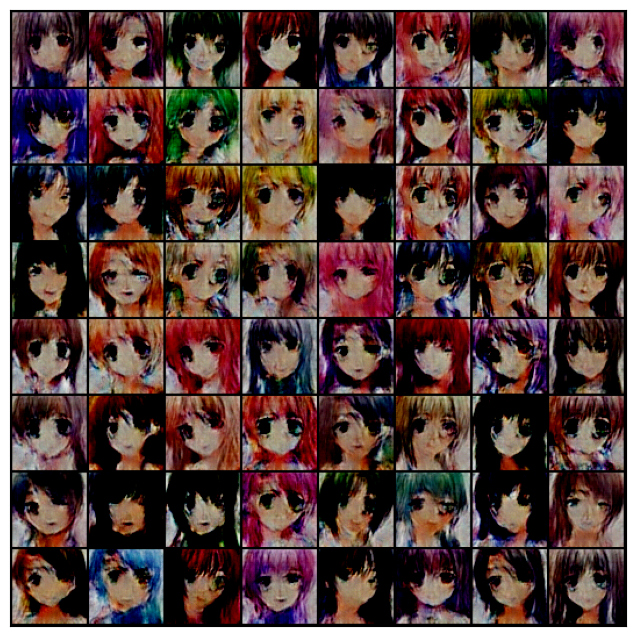

  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [92/100], loss_g: 0.5449, loss_d: 0.0430, real_score: 0.8509, fake_score: 0.1450


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [93/100], loss_g: 0.4311, loss_d: 0.0723, real_score: 0.8562, fake_score: 0.1412


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [94/100], loss_g: 0.4654, loss_d: 0.0391, real_score: 0.8331, fake_score: 0.1496


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [95/100], loss_g: 0.4046, loss_d: 0.0388, real_score: 0.8567, fake_score: 0.1832


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [96/100], loss_g: 0.3983, loss_d: 0.0583, real_score: 0.7896, fake_score: 0.1963


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [97/100], loss_g: 0.5859, loss_d: 0.0424, real_score: 0.8199, fake_score: 0.1237


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [98/100], loss_g: 0.4638, loss_d: 0.0181, real_score: 0.8017, fake_score: 0.0840


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [99/100], loss_g: 0.4201, loss_d: 0.0938, real_score: 0.8816, fake_score: 0.2013


  0%|          | 0/12 [00:00<?, ?it/s]

Epoch [100/100], loss_g: 0.4533, loss_d: 0.0371, real_score: 0.8195, fake_score: 0.1509


In [ ]:
# Complete the training function
losses_g = []
losses_d = []
real_scores = []
fake_scores = []
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for real_images in tqdm(trainloader):
            real_images=real_images.to(device)
            # Pass real images through discriminator
            D_out_real = D(real_images)
            label_real = torch.full(D_out_real.shape, 1.0).to(torch.device(device))
            real_loss = Real_loss(label_real,D_out_real)
            real_score = torch.mean(D_out_real).item()

            # Generate fake images
            noise = torch.randn(batch_size, latent_size, 1, 1).to(torch.device(device))
            fake_images =  G(noise)

            # Pass fake images through discriminator
            D_out_fake = D(fake_images)
            label_fake =  torch.full(D_out_fake.shape, 0).to(torch.device(device))
            fake_loss = Fake_loss(label_fake, D_out_fake)
            fake_score = torch.mean(D_out_fake).item()

            # Update discriminator weights
            loss_d = real_loss + fake_loss

            d_optimizer.zero_grad()
            loss_d.backward(retain_graph = True)
            d_optimizer.step()

            # Generate fake images
            noise2 = torch.randn(batch_size, latent_size, 1, 1).to(torch.device(device))
            fake_images2 =  G(noise2)

            gen_steps = 1
            for i in range(0, gen_steps ):
            # Try to fool the discriminator
                D_out_fake2 = D(fake_images2)

                # The label is set to 1(real-like) to fool the discriminator
                label_real1 = torch.full(D_out_fake2.shape, 1.0).to(torch.device(device))
                loss_g = Real_loss(label_real1, D_out_fake2)

                # Update generator weights
                g_optimizer.zero_grad()
                loss_g.backward(retain_graph = (i<gen_steps -1 ))
                g_optimizer.step()


        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        if epoch % 10 == 0:
          save_samples(epoch+start_idx, fixed_latent,G, show=True)

          state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
          state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
          if not os.path.isdir('checkpoint'):
              os.mkdir('checkpoint')
          torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(D,G,opt_d,opt_g,epochs=100)

torch.Size([8, 3, 64, 64])


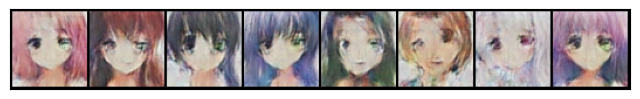

In [ ]:
# random latent tensors

fake_images = G(noise)
print(fake_images.shape)

fake_images.to(device)

show_images(fake_images)

torch.Size([8, 3, 64, 64])


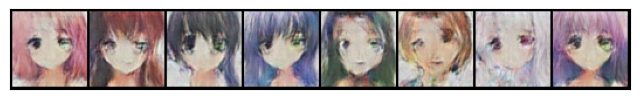

In [ ]:
# random latent tensors
noise = torch.randn(batch_size, latent_size, 1, 1).to(device)

fake_images = G(noise)
print(fake_images.shape)

fake_images.to(device)

show_images(fake_images)